In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 977.3/977.3 kB 16.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 66.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 35.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 42.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 80.0 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [ ]:
import os
import zipfile
import yaml
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict

# Step 1: Extract the ZIP file
def extract_zip(zip_path, extract_to):
    """
    Extract the ZIP file to a specified directory.

    Args:
        zip_path (str): Path to the ZIP file.
        extract_to (str): Directory to extract the contents to.
    """
    if not os.path.exists(extract_to):
        os.makedirs(extract_to)
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)
    print(f"Extracted ZIP file to {extract_to}")


def load_data_yaml(yaml_path):
    """
    Load the data.yaml file to get dataset configuration.

    Args:
        yaml_path (str): Path to the data.yaml file.

    Returns:
        dict: Contents of the YAML file.
    """
    with open(yaml_path, 'r') as f:
        data = yaml.safe_load(f)
    return data

In [ ]:
if __name__ == "__main__":
    zip_path = "/content/drive/MyDrive/contents/dataset_yolo_final-20250330T235651Z-001.zip"  # Path to your ZIP file
    extract_to = "/content/drive/MyDrive/dataset_yolo_final"  # Directory to extract the dataset

    # Call the extract_zip function explicitly
    extract_zip(zip_path, extract_to)

Extracted ZIP file to /content/drive/MyDrive/dataset_yolo_final


In [ ]:
dataset_dir = "/content/drive/MyDrive/dataset_yolo_final/dataset_yolo_final/dataset_yolo"
data_yaml_path = os.path.join(dataset_dir, "data.yaml")

with open(data_yaml_path, 'r') as f:
    data_config = yaml.safe_load(f)

class_names = data_config['names']
num_classes = data_config['nc']

print(f"Number of classes: {num_classes}")
print(f"Class names: {class_names}")

Number of classes: 11
Class names: ['Ascending Triangle', 'Cup and Handle', 'Descending Triangle', 'Double Bottom', 'Double Top', 'Falling Wedge', 'Head and Shoulder', 'Inverse Head and Shoulder', 'Symmetric Triangle', 'Triple Bottom Reversal', 'flag-and-pole']


In [ ]:
splits = ['train', 'valid', 'test']
split_counts = {}
class_counts = defaultdict(lambda: defaultdict(int))
bbox_sizes, bbox_aspect_ratios, bbox_positions = [], [], []

for split in splits:
    image_dir = os.path.join(dataset_dir, split, 'images')
    label_dir = os.path.join(dataset_dir, split, 'labels')

    if not os.path.exists(image_dir) or not os.path.exists(label_dir):
        continue

    images = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]
    split_counts[split] = len(images)

    for img_file in images:
        img_path = os.path.join(image_dir, img_file)
        img = cv2.imread(img_path)
        if img is None:
            continue
        h, w, _ = img.shape

        label_file = os.path.splitext(img_file)[0] + '.txt'
        label_path = os.path.join(label_dir, label_file)

        if not os.path.exists(label_path):
            continue

        with open(label_path, 'r') as f:
            annotations = f.readlines()

        for annotation in annotations:
            cls_id, xc, yc, bw, bh = map(float, annotation.split())
            cls_id = int(cls_id)
            cls_name = class_names[cls_id]
            class_counts[split][cls_name] += 1

            bbox_w, bbox_h = bw * w, bh * h
            bbox_sizes.append((cls_name, bbox_w, bbox_h))
            bbox_aspect_ratios.append((cls_name, bbox_w / bbox_h if bbox_h != 0 else 0))
            bbox_positions.append((xc, yc))


print("Split counts:", split_counts)


Split counts: {'train': 1176, 'valid': 289}


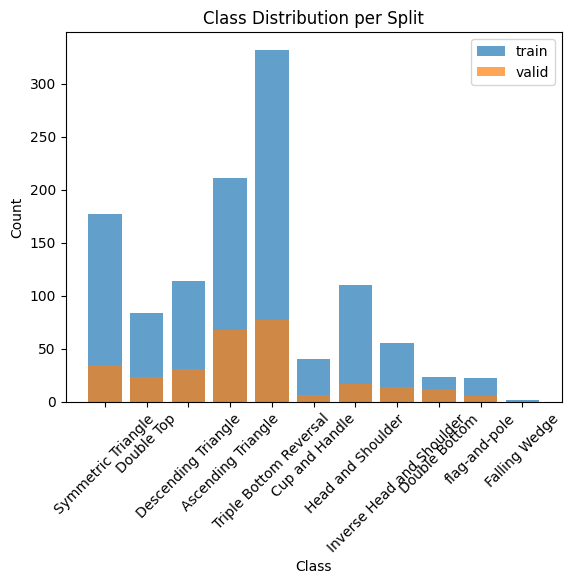

In [ ]:
for split in class_counts:
    plt.bar(class_counts[split].keys(), class_counts[split].values(), alpha=0.7, label=split)
plt.title("Class Distribution per Split")
plt.xlabel("Class")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.legend()
plt.show()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Directories not found for test: /content/drive/MyDrive/dataset_yolo_final/dataset_yolo/test/images, /content/drive/MyDrive/dataset_yolo_final/dataset_yolo/test/labels
Split counts: {'train': 1176, 'valid': 289}
Class counts: {'train': defaultdict(<class 'int'>, {'Symmetric Triangle': 177, 'Double Top': 84, 'Descending Triangle': 114, 'Ascending Triangle': 211, 'Triple Bottom Reversal': 332, 'Cup and Handle': 40, 'Head and Shoulders': 110, 'Inverse Head and Shoulders': 55, 'Double Bottom': 23, 'flag-and-pole': 22, 'Falling Wedge': 2}), 'valid': defaultdict(<class 'int'>, {'Symmetric Triangle': 35, 'Double Top': 23, 'Ascending Triangle': 68, 'Triple Bottom Reversal': 77, 'Double Bottom': 12, 'Descending Triangle': 31, 'Inverse Head and Shoulders': 14, 'Cup and Handle': 6, 'Head and Shoulders': 17, 'flag-and-pole': 5}), 'test': defaultdict(<class 'int'>, {})}


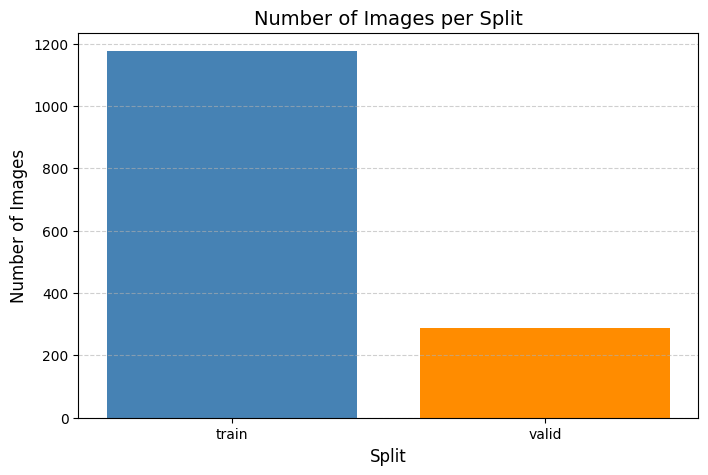

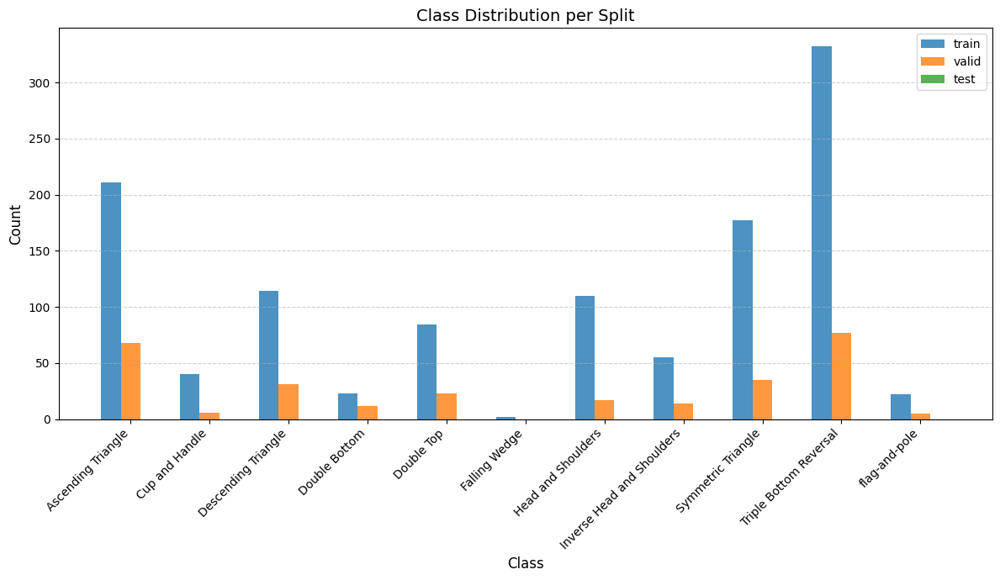

In [ ]:
import os
import matplotlib.pyplot as plt
from collections import defaultdict

def count_dataset(dataset_dir):
    """Count images per split and class distribution."""
    split_counts = {}
    class_counts = {'train': defaultdict(int), 'valid': defaultdict(int), 'test': defaultdict(int)}
    class_names = {
    0: "Ascending Triangle", 1: "Cup and Handle", 2: "Descending Triangle",
    3: "Double Bottom", 4: "Double Top", 5: "Falling Wedge",
    6: "Head and Shoulders", 7: "Inverse Head and Shoulders", 8: "Symmetric Triangle",
    9: "Triple Bottom Reversal", 10: "flag-and-pole"
}


    splits = ['train', 'valid', 'test']
    for split in splits:
        image_dir = os.path.join(dataset_dir, split, "images")
        label_dir = os.path.join(dataset_dir, split, "labels")

        if not os.path.exists(image_dir) or not os.path.exists(label_dir):
            print(f"Directories not found for {split}: {image_dir}, {label_dir}")
            continue

        images = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]
        split_counts[split] = len(images)

        for img_file in images:
            label_file = os.path.splitext(img_file)[0] + '.txt'
            label_path = os.path.join(label_dir, label_file)

            if not os.path.exists(label_path):
                continue

            with open(label_path, 'r') as f:
                annotations = f.readlines()

            for annotation in annotations:
                if annotation.strip():
                    class_id = int(annotation.strip().split()[0])
                    if class_id in class_names:
                        class_counts[split][class_names[class_id]] += 1

    return split_counts, class_counts, list(class_names.values())

def plot_dataset(dataset_dir):
    """Plot split counts and class distribution."""
    split_counts, class_counts, class_list = count_dataset(dataset_dir)
    print("Split counts:", split_counts)
    print("Class counts:", dict(class_counts))

    # Plot split counts
    plt.figure(figsize=(8, 5))
    plt.bar(split_counts.keys(), split_counts.values(), color=['steelblue', 'darkorange'])
    plt.title("Number of Images per Split", fontsize=14)
    plt.xlabel("Split", fontsize=12)
    plt.ylabel("Number of Images", fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.show()

    # Plot class distribution per split
    plt.figure(figsize=(12, 7))
    width = 0.25
    x = range(len(class_list))

    for i, split in enumerate(['train', 'valid', 'test']):
        if split in class_counts:
            counts = [class_counts[split][cls] for cls in class_list]
            plt.bar([p + width*i for p in x], counts, width=width, alpha=0.8, label=split)

    plt.title("Class Distribution per Split", fontsize=14)
    plt.xlabel("Class", fontsize=12)
    plt.ylabel("Count", fontsize=12)
    plt.xticks([p + width for p in x], class_list, rotation=45, ha='right')
    plt.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    from google.colab import drive
    drive.mount('/content/drive')

    dataset_dir = "/content/drive/MyDrive/dataset_yolo_final/dataset_yolo"
    plot_dataset(dataset_dir)

/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:87: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)
<ipython-input-10-1d5ed9a0cc69>:11: UserWarning: Argument(s) 'var_limit' are not valid for transform GaussNoise
  GaussNoise(var_limit=(10, 50), p=0.5),


Original counts before augmentation:
Split counts: {'train': 1176, 'valid': 289}
Class counts: {'train': defaultdict(<class 'int'>, {'Descending Triangle': 114, 'Triple Bottom Reversal': 332, 'Ascending Triangle': 211, 'Head and Shoulders': 110, 'Double Top': 84, 'Symmetric Triangle': 177, 'Inverse Head and Shoulders': 55, 'Cup and Handle': 40, 'flag-and-pole': 22, 'Double Bottom': 23, 'Falling Wedge': 2}), 'valid': defaultdict(<class 'int'>, {'Ascending Triangle': 68, 'Double Top': 23, 'Symmetric Triangle': 35, 'Triple Bottom Reversal': 77, 'Cup and Handle': 6, 'Double Bottom': 12, 'Head and Shoulders': 17, 'Inverse Head and Shoulders': 14, 'Descending Triangle': 31, 'flag-and-pole': 5})}
Total counts for minority classes: {1: 46, 10: 27, 3: 35, 5: 2}


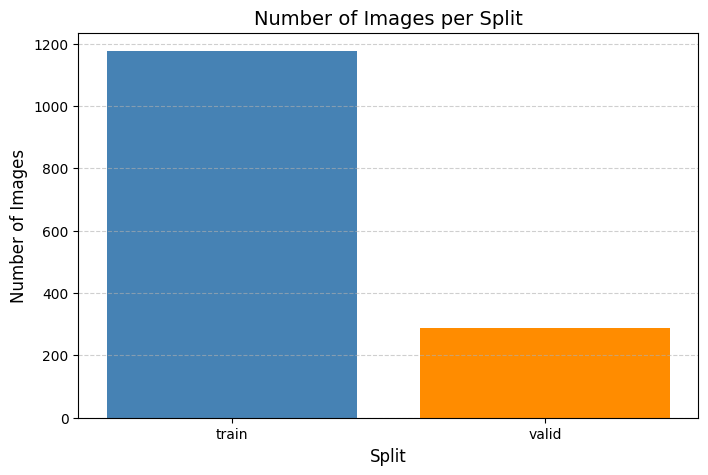

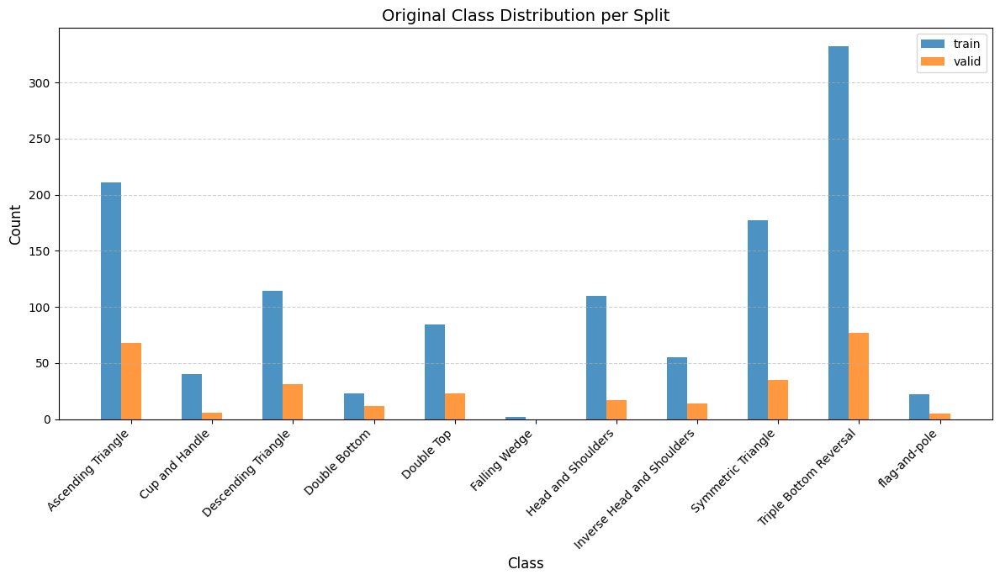

Augmenting minority classes in train split...
Augmenting minority classes in valid split...
Final counts after augmentation:
Split counts: {'train': 1266, 'valid': 289}
Class counts: {'train': defaultdict(<class 'int'>, {'Descending Triangle': 114, 'Triple Bottom Reversal': 332, 'Ascending Triangle': 211, 'Head and Shoulders': 110, 'Double Top': 84, 'Symmetric Triangle': 177, 'Inverse Head and Shoulders': 55, 'Cup and Handle': 44, 'flag-and-pole': 45, 'Double Bottom': 38, 'Falling Wedge': 50}), 'valid': defaultdict(<class 'int'>, {'Ascending Triangle': 68, 'Double Top': 23, 'Symmetric Triangle': 35, 'Triple Bottom Reversal': 77, 'Cup and Handle': 6, 'Double Bottom': 12, 'Head and Shoulders': 17, 'Inverse Head and Shoulders': 14, 'Descending Triangle': 31, 'flag-and-pole': 5})}
Total counts for minority classes: {1: 50, 10: 50, 3: 50, 5: 50}


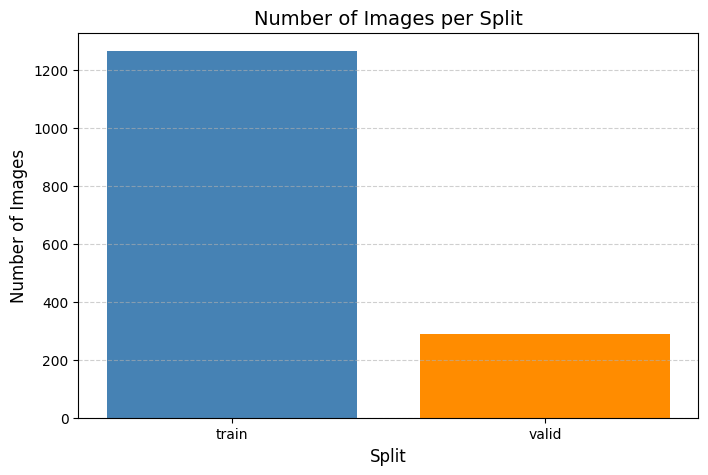

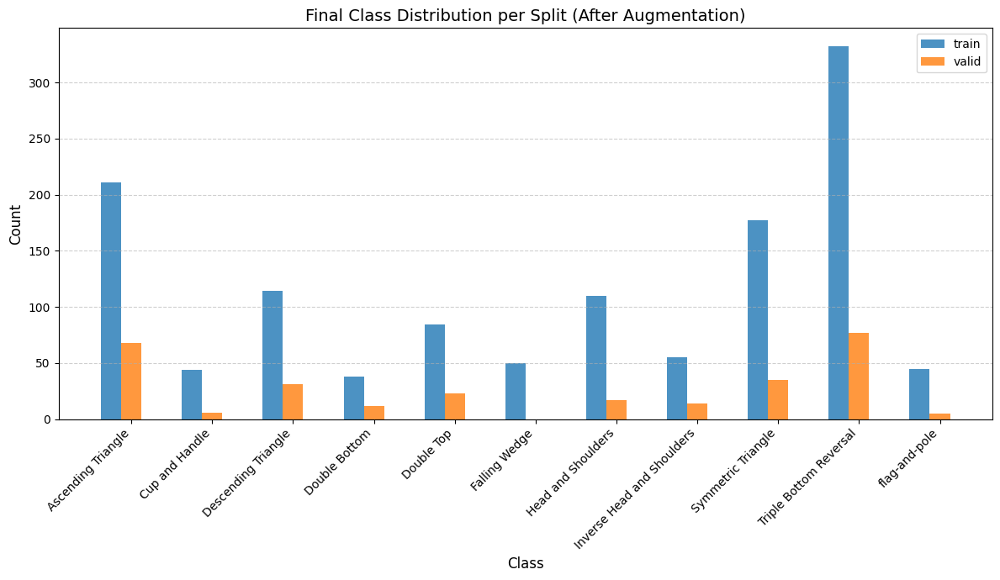

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
from collections import defaultdict
from albumentations import Compose, ShiftScaleRotate, RandomBrightnessContrast, GaussNoise

# Safe Augmentation for Time Series Chart Patterns
aug = Compose([
    ShiftScaleRotate(shift_limit=0.1, scale_limit=0, rotate_limit=0, p=0.5),
    RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=0.5),
    GaussNoise(var_limit=(10, 50), p=0.5),
])

def get_class_id_from_label(label_path):
    """Read the YOLO label file and return the class ID of the first annotation."""
    try:
        with open(label_path, 'r') as f:
            lines = f.readlines()
        if not lines:
            return None
        return int(lines[0].strip().split()[0])
    except Exception as e:
        print(f"Error reading {label_path}: {e}")
        return None

def adjust_label_coordinates(label_path, output_label_path, crop_top_ratio=0.1, crop_bottom_ratio=0.1, crop_right_ratio=0.05):
    """Adjust YOLO label coordinates after cropping."""
    with open(label_path, 'r') as f:
        lines = f.readlines()
    adjusted_lines = []
    for line in lines:
        class_id, x_center, y_center, width, height = map(float, line.strip().split())
        y_center = (y_center - crop_top_ratio) / (1 - crop_top_ratio - crop_bottom_ratio)
        x_center = x_center / (1 - crop_right_ratio)
        width = width / (1 - crop_right_ratio)
        height = height / (1 - crop_top_ratio - crop_bottom_ratio)
        if 0 <= y_center <= 1 and 0 <= x_center <= 1:
            adjusted_lines.append(f"{int(class_id)} {x_center} {y_center} {width} {height}\n")
    with open(output_label_path, 'w') as f:
        f.writelines(adjusted_lines)

def count_dataset(dataset_dir):
    """Count images per split and class distribution."""
    split_counts = {}
    class_counts = {'train': defaultdict(int), 'valid': defaultdict(int)}
    total_class_counts = defaultdict(int)  # Total across both splits
    class_names = {
0: "Ascending Triangle", 1: "Cup and Handle", 2: "Descending Triangle",
    3: "Double Bottom", 4: "Double Top", 5: "Falling Wedge",
    6: "Head and Shoulders", 7: "Inverse Head and Shoulders", 8: "Symmetric Triangle",
    9: "Triple Bottom Reversal", 10: "flag-and-pole"
    }
    minority_class_ids = [1,3, 5, 10]  # Flag-and-Pole, Double Bottom, Cup and Handle, Falling Wedge

    for split in ["train", "valid"]:
        image_dir = os.path.join(dataset_dir, split, "images")
        label_dir = os.path.join(dataset_dir, split, "labels")

        if not os.path.exists(image_dir) or not os.path.exists(label_dir):
            print(f"Directories not found for {split}: {image_dir}, {label_dir}")
            continue

        split_counts[split] = len([f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png'))])

        for label_name in os.listdir(label_dir):
            if not label_name.endswith('.txt'):
                continue
            label_path = os.path.join(label_dir, label_name)
            class_id = get_class_id_from_label(label_path)
            if class_id is not None and class_id in class_names:
                class_counts[split][class_names[class_id]] += 1
                if class_id in minority_class_ids:
                    total_class_counts[class_id] += 1

    return split_counts, class_counts, total_class_counts, list(class_names.values()), minority_class_ids

def augment_images(image_dir, label_dir, minority_class_ids, total_class_counts, target_total=50):
    """Augment minority class images to reach a target total of 50 instances across both splits."""
    for label_name in os.listdir(label_dir):
        if not label_name.endswith('.txt'):
            continue
        label_path = os.path.join(label_dir, label_name)
        class_id = get_class_id_from_label(label_path)

        if class_id not in minority_class_ids:
            continue

        current_total = total_class_counts[class_id]
        if current_total >= target_total:
            continue  # No augmentation needed if already at or above 50
        images_to_add = target_total - current_total

        img_name = label_name.replace('.txt', '.jpg')
        img_path = os.path.join(image_dir, img_name)
        if not os.path.exists(img_path):
            img_name = label_name.replace('.txt', '.png')
            img_path = os.path.join(image_dir, img_name)
        if not os.path.exists(img_path):
            print(f"Image not found for {label_name}")
            continue

        img = cv2.imread(img_path)
        if img is None:
            print(f"Failed to load {img_path}")
            continue

        base_name = os.path.splitext(img_name)[0]
        images_added = 0
        count = 0
        while images_added < images_to_add:
            aug_img = aug(image=img)['image']
            aug_img_name = f"aug_{count}_{base_name}.jpg"
            cv2.imwrite(os.path.join(image_dir, aug_img_name), aug_img)

            aug_label_name = f"aug_{count}_{base_name}.txt"
            adjust_label_coordinates(label_path, os.path.join(label_dir, aug_label_name))
            images_added += 1
            count += 1
            total_class_counts[class_id] += 1  # Update total count
            if total_class_counts[class_id] >= target_total:
                break

def process_and_augment_dataset(dataset_dir):
    """Augment minority classes and plot the distribution."""
    # Step 1: Count the original dataset
    split_counts, class_counts, total_class_counts, class_list, minority_class_ids = count_dataset(dataset_dir)
    print("Original counts before augmentation:")
    print("Split counts:", split_counts)
    print("Class counts:", dict(class_counts))
    print("Total counts for minority classes:", dict(total_class_counts))

    # Step 2: Plot the original distribution
    plot_dataset(split_counts, class_counts, class_list, title="Original Class Distribution per Split")

    # Step 3: Augment minority classes
    for split in ["train", "valid"]:
        image_dir = os.path.join(dataset_dir, split, "images")
        label_dir = os.path.join(dataset_dir, split, "labels")

        if not os.path.exists(image_dir) or not os.path.exists(label_dir):
            print(f"Directories not found for {split}: {image_dir}, {label_dir}")
            continue

        print(f"Augmenting minority classes in {split} split...")
        augment_images(image_dir, label_dir, minority_class_ids, total_class_counts, target_total=50)

    # Step 4: Plot the final distribution
    split_counts, class_counts, total_class_counts, class_list, minority_class_ids = count_dataset(dataset_dir)
    print("Final counts after augmentation:")
    print("Split counts:", split_counts)
    print("Class counts:", dict(class_counts))
    print("Total counts for minority classes:", dict(total_class_counts))
    plot_dataset(split_counts, class_counts, class_list, title="Final Class Distribution per Split (After Augmentation)")

def plot_dataset(split_counts, class_counts, class_list, title="Class Distribution per Split"):
    """Plot split counts and class distribution."""
    # Plot split counts
    plt.figure(figsize=(8, 5))
    plt.bar(split_counts.keys(), split_counts.values(), color=['steelblue', 'darkorange'])
    plt.title("Number of Images per Split", fontsize=14)
    plt.xlabel("Split", fontsize=12)
    plt.ylabel("Number of Images", fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.show()

    # Plot class distribution per split
    plt.figure(figsize=(12, 7))
    width = 0.25
    x = range(len(class_list))

    for i, split in enumerate(['train', 'valid']):
        counts = [class_counts[split][cls] for cls in class_list]
        plt.bar([p + width*i for p in x], counts, width=width, alpha=0.8, label=split)

    plt.title(title, fontsize=14)
    plt.xlabel("Class", fontsize=12)
    plt.ylabel("Count", fontsize=12)
    plt.xticks([p + width for p in x], class_list, rotation=45, ha='right')
    plt.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    try:
        import albumentations
    except ImportError:
        os.system("pip install albumentations")


    dataset_dir = "/content/drive/MyDrive/dataset_yolo_final/dataset_yolo"
    process_and_augment_dataset(dataset_dir)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.

Class Distribution in Validation Set:
Ascending Triangle: 68 instances
Cup and Handle: 6 instances
Descending Triangle: 31 instances
Double Bottom: 12 instances
Double Top: 23 instances
Falling Wedge: 0 instances
Head and Shoulders: 17 instances
Inverse Head and Shoulders: 14 instances
Symmetric Triangle: 35 instances
Triple Bottom Reversal: 77 instances
flag-and-pole: 5 instances
Error downloading or loading model from Hugging Face: 404 Client Error. (Request ID: Root=1-67eeda99-7b586b85583332d8369da639;901e5b1f-8d9e-41c4-b7ae-39cc366cd50f)

Entry Not Found for url: https://huggingface.co/foduucom/stockmarket-pattern-detection-yolov8/resolve/main/best.pt.
Falling back to default

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
100%|██████████| 49.7M/49.7M [00:00<00:00, 164MB/s]


Freezing layer: model.0.conv.weight
Freezing layer: model.0.bn.weight
Freezing layer: model.0.bn.bias
Freezing layer: model.1.conv.weight
Freezing layer: model.1.bn.weight
Freezing layer: model.1.bn.bias
Freezing layer: model.2.cv1.conv.weight
Freezing layer: model.2.cv1.bn.weight
Freezing layer: model.2.cv1.bn.bias
Freezing layer: model.2.cv2.conv.weight
Freezing layer: model.2.cv2.bn.weight
Freezing layer: model.2.cv2.bn.bias
Freezing layer: model.2.m.0.cv1.conv.weight
Freezing layer: model.2.m.0.cv1.bn.weight
Freezing layer: model.2.m.0.cv1.bn.bias
Freezing layer: model.2.m.0.cv2.conv.weight
Freezing layer: model.2.m.0.cv2.bn.weight
Freezing layer: model.2.m.0.cv2.bn.bias
Freezing layer: model.2.m.1.cv1.conv.weight
Freezing layer: model.2.m.1.cv1.bn.weight
Freezing layer: model.2.m.1.cv1.bn.bias
Freezing layer: model.2.m.1.cv2.conv.weight
Freezing layer: model.2.m.1.cv2.bn.weight
Freezing layer: model.2.m.1.cv2.bn.bias
Freezing layer: model.3.conv.weight
Freezing layer: model.3.bn.w

100%|██████████| 755k/755k [00:00<00:00, 14.1MB/s]


Overriding model.yaml nc=80 with nc=11

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 65.1MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/dataset_yolo_final/dataset_yolo_final/dataset_yolo/train/labels.cache... 1266 images, 6 backgrounds, 0 corrupt: 100%|██████████| 1266/1266 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/dataset_yolo_final/dataset_yolo_final/dataset_yolo/valid/labels.cache... 289 images, 1 backgrounds, 0 corrupt: 100%|██████████| 289/289 [00:00<?, ?it/s]


Plotting labels to runs/train/exp_frozen/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000667, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/train/exp_frozen
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      6.35G      2.223      20.26      2.228          2        640: 100%|██████████| 80/80 [02:53<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:07<00:00,  1.43it/s]


                   all        289        288      0.935     0.0312     0.0473     0.0163

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      7.53G       2.06      14.28      2.123          2        640: 100%|██████████| 80/80 [00:39<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.88it/s]

                   all        289        288      0.539       0.11     0.0443     0.0149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      7.53G      2.061      12.91      2.131          2        640: 100%|██████████| 80/80 [00:40<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.23it/s]

                   all        289        288      0.928     0.0403     0.0588      0.019



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      7.59G      2.064      12.37      2.095          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.30it/s]

                   all        289        288      0.445      0.131     0.0697     0.0264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      7.66G      2.041      11.79      2.066          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.17it/s]

                   all        289        288      0.198      0.172     0.0831      0.032



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      7.73G      1.988      11.34      2.038          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.38it/s]

                   all        289        288      0.411      0.193      0.122     0.0432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      7.79G      1.947       11.1      2.008          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.06it/s]

                   all        289        288      0.387      0.214      0.108     0.0408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      7.83G      1.896      10.61      1.954          2        640: 100%|██████████| 80/80 [00:40<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.36it/s]

                   all        289        288      0.172      0.207      0.112     0.0481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      7.83G      1.865      10.34      1.919          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.35it/s]

                   all        289        288       0.32      0.241      0.147     0.0609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      7.83G      1.803      10.08      1.912          2        640: 100%|██████████| 80/80 [00:40<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.85it/s]

                   all        289        288      0.314      0.238       0.14     0.0631



10 epochs completed in 0.174 hours.
Optimizer stripped from runs/train/exp_frozen/weights/last.pt, 52.0MB
Optimizer stripped from runs/train/exp_frozen/weights/best.pt, 52.0MB

Validating runs/train/exp_frozen/weights/best.pt...
Ultralytics 8.3.101 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,846,129 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:06<00:00,  1.64it/s]


                   all        289        288      0.316      0.239      0.141     0.0633
    Ascending Triangle         68         68        0.2      0.176      0.114     0.0384
        Cup and Handle          6          6          1          0      0.172      0.118
   Descending Triangle         31         31     0.0826      0.145     0.0609      0.023
         Double Bottom         12         12      0.112     0.0746     0.0375     0.0211
            Double Top         23         23        0.2      0.565       0.22     0.0814
     Head and Shoulder         17         17      0.083      0.471      0.122     0.0454
Inverse Head and Shoulder         14         14          0          0     0.0859     0.0444
    Symmetric Triangle         35         35      0.249      0.162      0.163     0.0526
Triple Bottom Reversal         77         77      0.229      0.792      0.396      0.181
         flag-and-pole          5          5          1          0      0.036     0.0277
Speed: 0.3ms prepr

train: Scanning /content/drive/MyDrive/dataset_yolo_final/dataset_yolo_final/dataset_yolo/train/labels.cache... 1266 images, 6 backgrounds, 0 corrupt: 100%|██████████| 1266/1266 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/dataset_yolo_final/dataset_yolo_final/dataset_yolo/valid/labels.cache... 289 images, 1 backgrounds, 0 corrupt: 100%|██████████| 289/289 [00:00<?, ?it/s]


Plotting labels to runs/train/exp_unfrozen/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000667, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/train/exp_unfrozen
Starting training for 90 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/90       6.9G      2.075      12.45      1.979          5        640: 100%|██████████| 80/80 [00:43<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.07it/s]

                   all        289        288      0.273      0.155     0.0884     0.0385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/90      8.04G      1.964      12.04      1.948          6        640: 100%|██████████| 80/80 [00:41<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.94it/s]

                   all        289        288      0.267      0.227     0.0976     0.0354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/90      8.04G       1.98      12.03      1.934          1        640: 100%|██████████| 80/80 [00:41<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.465     0.0786     0.0843     0.0284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/90      8.04G      1.981      12.13       1.98          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.40it/s]

                   all        289        288      0.675     0.0815     0.0729     0.0252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/90      8.04G      1.933      11.95       1.92          3        640: 100%|██████████| 80/80 [00:41<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.94it/s]


                   all        289        288      0.386      0.193      0.112     0.0433

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/90      8.05G      1.923      11.88      1.926          1        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288      0.471      0.115      0.107     0.0426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/90      8.12G      1.898      11.77        1.9          2        640: 100%|██████████| 80/80 [00:42<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.43it/s]

                   all        289        288      0.221      0.192      0.117     0.0424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/90      8.18G       1.89      11.74      1.888          3        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.96it/s]

                   all        289        288      0.417      0.218      0.123     0.0556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/90      8.25G      1.886      11.31       1.86          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.34it/s]

                   all        289        288       0.26      0.142     0.0892     0.0344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/90      8.32G      1.843      11.26      1.848          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.37it/s]

                   all        289        288      0.263      0.265      0.138     0.0544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/90      8.35G       1.87      11.15      1.859          4        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.94it/s]

                   all        289        288      0.228       0.22      0.113     0.0396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/90      8.35G      1.832       11.1       1.85          4        640: 100%|██████████| 80/80 [00:41<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.31it/s]

                   all        289        288       0.23      0.189      0.138     0.0636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/90      8.35G      1.849      10.94      1.861          3        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.38it/s]

                   all        289        288       0.38      0.232      0.115      0.048



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/90      8.35G      1.814      10.97      1.824          3        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.98it/s]

                   all        289        288      0.193      0.249      0.154     0.0562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/90      8.35G      1.803      10.81      1.834          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288      0.249      0.243      0.138     0.0531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/90      8.35G      1.827      10.75      1.829          4        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288      0.218       0.24      0.135     0.0581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/90      8.38G      1.821      10.95      1.825          4        640: 100%|██████████| 80/80 [00:40<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.01it/s]

                   all        289        288      0.362      0.198      0.133     0.0558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/90      8.39G      1.792      10.74      1.828          3        640: 100%|██████████| 80/80 [00:42<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288       0.25      0.295      0.144     0.0525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/90      8.39G       1.76      10.79      1.814          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.314      0.192      0.148     0.0635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/90      8.39G      1.749      10.65      1.801          3        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.99it/s]

                   all        289        288       0.39      0.268      0.173     0.0755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/90      8.39G      1.791      10.55       1.83          3        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.32it/s]

                   all        289        288      0.325      0.121      0.108     0.0401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/90      8.39G      1.785      10.39      1.799          4        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288       0.19      0.224       0.12     0.0522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/90      8.39G      1.767      10.23      1.788          5        640: 100%|██████████| 80/80 [00:41<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.01it/s]

                   all        289        288      0.149      0.234      0.154     0.0724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/90      8.39G      1.763      10.29       1.78          6        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.40it/s]

                   all        289        288      0.173      0.237      0.158     0.0651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/90      8.39G      1.779      10.38      1.807          5        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288      0.142      0.232      0.143     0.0573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/90      8.39G      1.756      10.21      1.797          3        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.01it/s]

                   all        289        288      0.237      0.264      0.177     0.0766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/90      8.39G      1.719      10.26      1.762          4        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.38it/s]

                   all        289        288      0.207       0.21      0.161     0.0706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/90      8.39G      1.722      10.13      1.769          3        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.91it/s]

                   all        289        288      0.195      0.235      0.164     0.0716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/90      8.39G      1.724      10.12       1.78          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.12it/s]

                   all        289        288      0.231       0.26       0.18     0.0822



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/90      8.39G      1.714      10.09      1.746          7        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.30it/s]


                   all        289        288      0.193      0.276      0.164     0.0799

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/90      8.39G      1.707      9.965      1.752          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.11it/s]

                   all        289        288       0.18      0.304      0.179     0.0835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/90      8.39G      1.722      9.823      1.765          3        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.184      0.303      0.164     0.0743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/90      8.39G      1.691      9.756      1.736          5        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.05it/s]

                   all        289        288      0.229       0.29      0.151     0.0656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/90      8.39G      1.703      9.985      1.746          4        640: 100%|██████████| 80/80 [00:42<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.26it/s]

                   all        289        288      0.211      0.299      0.194     0.0851



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/90      8.39G      1.681      9.797      1.731          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.34it/s]

                   all        289        288      0.181      0.272      0.167      0.074



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/90      8.39G      1.695      9.632       1.75          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.94it/s]

                   all        289        288      0.223      0.316      0.194     0.0882



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/90      8.39G      1.694      9.815      1.753          4        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.38it/s]

                   all        289        288      0.173      0.215      0.166     0.0778



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/90      8.39G      1.669      9.748      1.732          2        640: 100%|██████████| 80/80 [00:40<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.38it/s]

                   all        289        288      0.187      0.329      0.172     0.0792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/90      8.39G      1.682      9.568      1.739          5        640: 100%|██████████| 80/80 [00:41<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.99it/s]

                   all        289        288       0.17      0.278      0.167     0.0756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/90      8.39G      1.631      9.388      1.692          3        640: 100%|██████████| 80/80 [00:40<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.43it/s]

                   all        289        288      0.189      0.278      0.179     0.0816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/90      8.39G      1.669      9.472      1.728          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.06it/s]

                   all        289        288      0.203      0.261      0.177     0.0761



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/90      8.39G       1.67      9.341      1.715          7        640: 100%|██████████| 80/80 [00:40<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]

                   all        289        288      0.363      0.282      0.158     0.0707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/90      8.39G      1.649      9.517      1.716          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.42it/s]

                   all        289        288       0.17      0.279      0.165     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/90      8.39G      1.681      9.243      1.752          2        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.99it/s]

                   all        289        288      0.239      0.312      0.157     0.0705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/90      8.39G      1.646       9.32      1.712          3        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.39it/s]

                   all        289        288      0.197      0.274      0.161     0.0711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/90      8.39G      1.641       9.14      1.697          4        640: 100%|██████████| 80/80 [00:41<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.23it/s]

                   all        289        288      0.241      0.271      0.172     0.0734
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 36, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



46 epochs completed in 0.610 hours.
Optimizer stripped from runs/train/exp_unfrozen/weights/last.pt, 52.0MB
Optimizer stripped from runs/train/exp_unfrozen/weights/best.pt, 52.0MB

Validating runs/train/exp_unfrozen/weights/best.pt...
Ultralytics 8.3.101 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,846,129 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:06<00:00,  1.63it/s]


                   all        289        288      0.225      0.315      0.194      0.088
    Ascending Triangle         68         68       0.11      0.338     0.0861     0.0285
        Cup and Handle          6          6      0.024      0.167     0.0142    0.00615
   Descending Triangle         31         31      0.131      0.404      0.142     0.0598
         Double Bottom         12         12          0          0     0.0237     0.0113
            Double Top         23         23      0.598      0.261      0.349      0.121
     Head and Shoulder         17         17      0.282      0.353      0.191     0.0893
Inverse Head and Shoulder         14         14       0.55       0.35      0.318      0.185
    Symmetric Triangle         35         35     0.0991      0.314      0.128     0.0563
Triple Bottom Reversal         77         77      0.302      0.766      0.484        0.2
         flag-and-pole          5          5      0.151        0.2      0.208      0.123
Speed: 0.4ms prepr

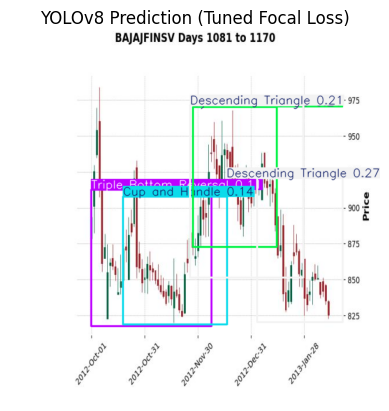

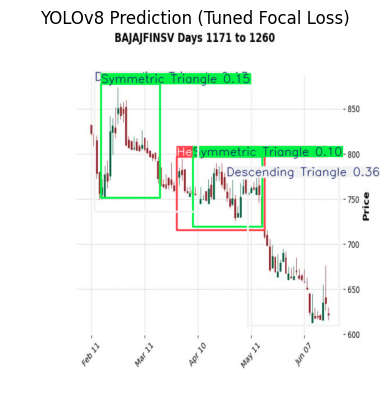

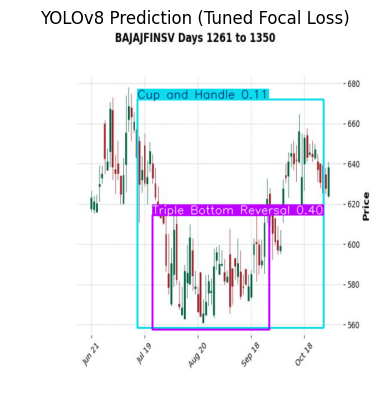

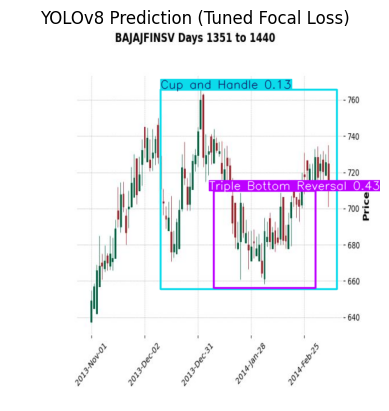

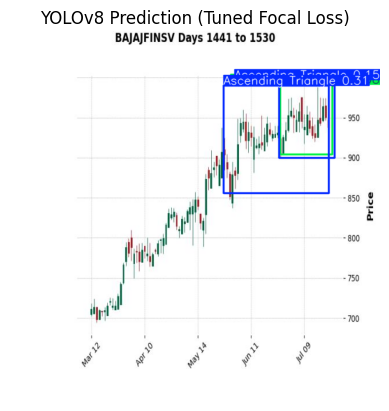

...

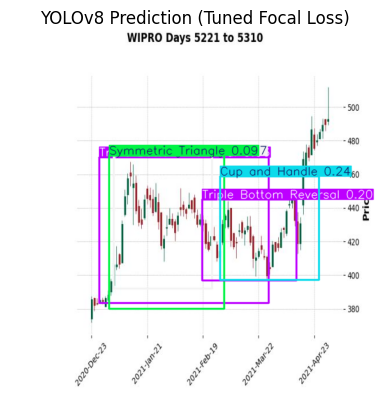

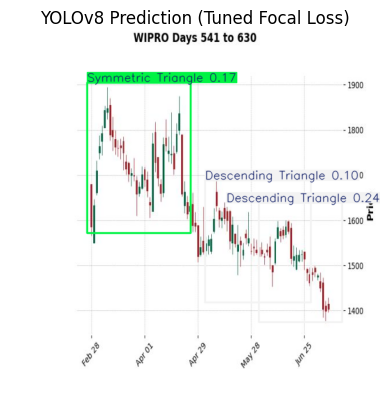

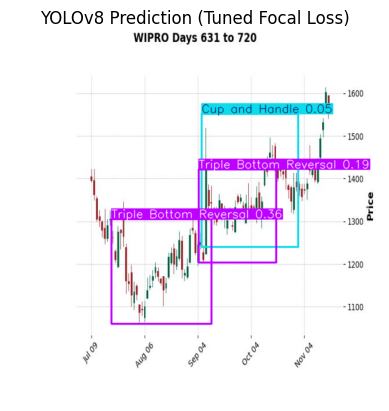

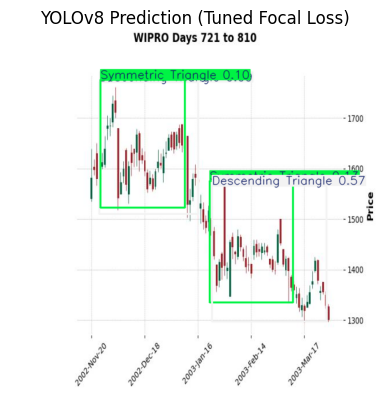

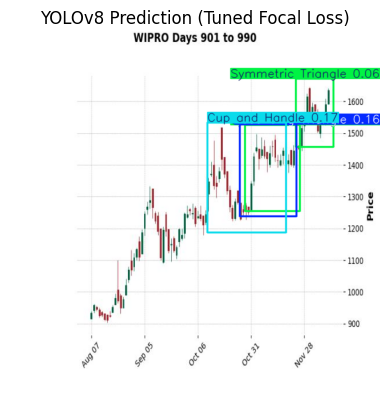

Predictions saved to runs/detect/predict
Using existing predictions in runs/detect/predict/exp/labels


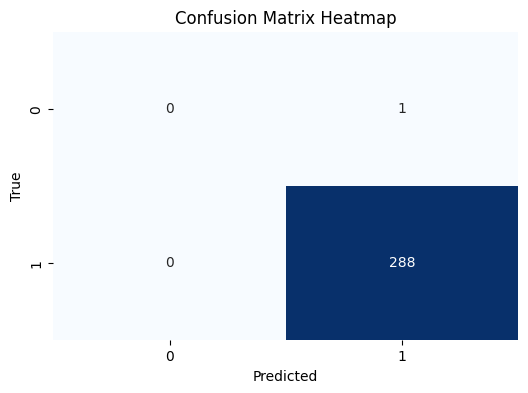

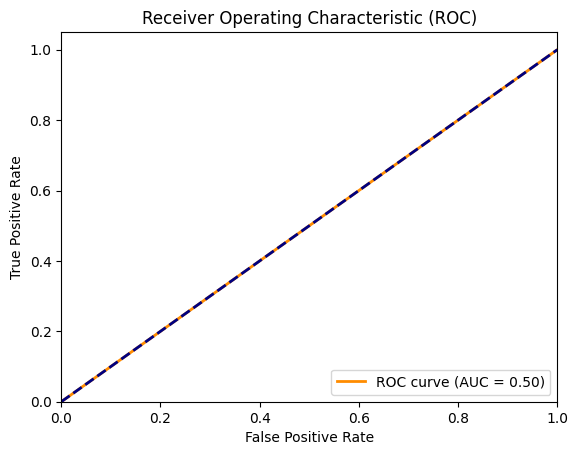

Metrics: {'accuracy': 0.9965397923875432, 'precision': 0.9965397923875432, 'recall': 1.0, 'f1_score': 0.9982668977469671, 'auc': np.float64(0.5)}
Using existing predictions in runs/detect/predict/exp/labels

Classification Report (Per Class):

                            precision    recall  f1-score   support

        Ascending Triangle      0.200     0.191     0.195        68
            Cup and Handle      0.033     0.167     0.056         6
       Descending Triangle      0.192     0.161     0.175        31
             Double Bottom      0.000     0.000     0.000        12
                Double Top      0.000     0.000     0.000        23
             Falling Wedge      0.000     0.000     0.000         0
        Head and Shoulders      0.062     0.059     0.061        17
Inverse Head and Shoulders      0.167     0.071     0.100        14
        Symmetric Triangle      0.153     0.257     0.191        35
    Triple Bottom Reversal      0.273     0.234     0.252        77
       

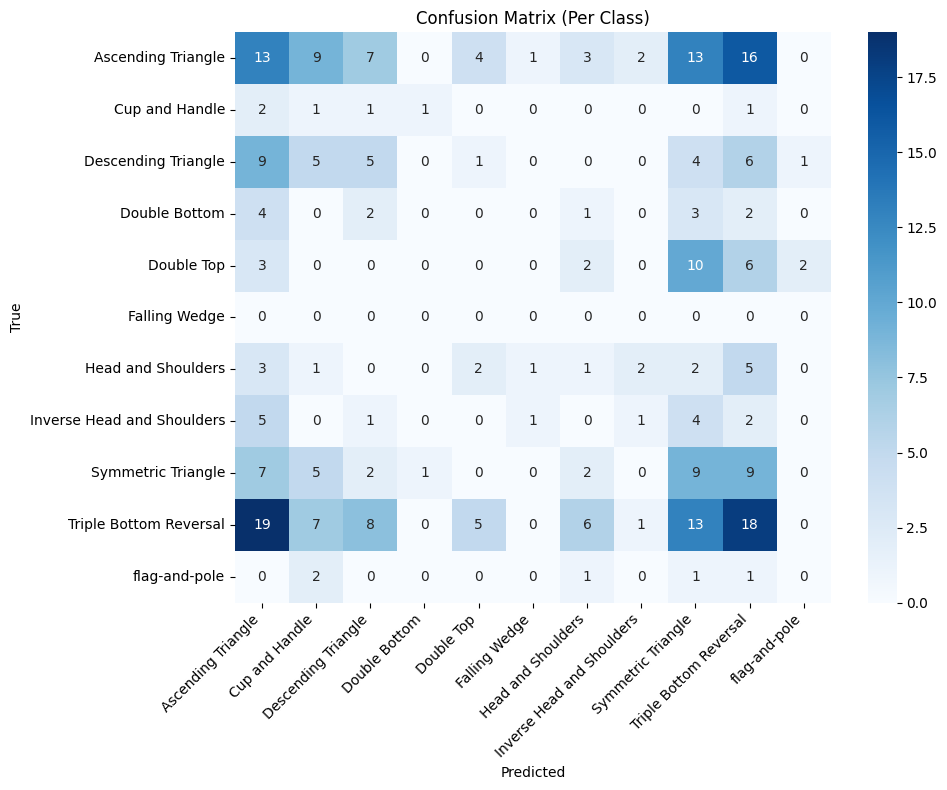


Micro-Average Metrics:
Micro Accuracy: 0.181
Micro Precision: 0.181
Micro Recall: 0.181
Micro F1-Score: 0.181

Macro-Average Metrics:
Macro Accuracy: 0.838
Macro Precision: 0.104
Macro Recall: 0.109
Macro F1-Score: 0.099


In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO
import torch
import torch.nn as nn
from ultralytics.utils.loss import v8DetectionLoss
from huggingface_hub import hf_hub_download
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, auc, classification_report
import seaborn as sns

# Custom Focal Loss Implementation
class CustomFocalLoss(nn.Module):
    def __init__(self, gamma=1.5, alpha=0.5, reduction='mean'):  # Adjusted gamma and alpha
        super().__init__()
        self.gamma = gamma
        self.alpha = alpha
        self.reduction = reduction
        self.bce = nn.BCEWithLogitsLoss(reduction='none')

    def forward(self, pred, target):
        bce_loss = self.bce(pred, target)
        p_t = torch.exp(-bce_loss)
        focal_loss = self.alpha * (1 - p_t) ** self.gamma * bce_loss
        if self.reduction == 'mean':
            return focal_loss.mean()
        elif self.reduction == 'sum':
            return focal_loss.sum()
        return focal_loss

# Custom Loss Class with Tunable Focal Loss
class Customv8DetectionLoss(v8DetectionLoss):
    def __init__(self, model, gamma=1.5, alpha=0.5):  # Adjusted gamma and alpha
        super().__init__(model)
        self.cls_loss_fn = CustomFocalLoss(gamma=gamma, alpha=alpha, reduction='mean')

    def __call__(self, preds, batch):
        return super().__call__(preds, batch)

# Load Pre-trained Model
def load_huggingface_model(repo_id="foduucom/stockmarket-pattern-detection-yolov8", filename="best.pt"):
    try:
        model_path = hf_hub_download(repo_id=repo_id, filename=filename)
        print(f"Pre-trained model downloaded to: {model_path}")
        model = YOLO(model_path)
        return model
    except Exception as e:
        print(f"Error downloading or loading model from Hugging Face: {e}")
        print("Falling back to default YOLOv8m model.")
        model = YOLO("yolov8m.pt")
        return model

# Train with Tunable Focal Loss and Two-Stage Freezing
def train_yolov8(data_yaml, model_save_path, epochs=100, img_size=640, gamma=1.5, alpha=0.5, dfl=1.5, box=7.5, cls=2.0, freeze_epochs=10):
    model = load_huggingface_model()
    if model is None:
        print("Failed to load pre-trained model. Exiting.")
        return None

    model.model.loss = Customv8DetectionLoss(model.model, gamma=gamma, alpha=alpha)

    torch_model = model.model
    num_layers = len(list(torch_model.modules()))
    freeze_until_layer = num_layers // 2
    layer_idx = 0
    for name, param in torch_model.named_parameters():
        if layer_idx < freeze_until_layer:
            param.requires_grad = False
            print(f"Freezing layer: {name}")
        else:
            param.requires_grad = True
        layer_idx += 1

    print(f"Training with frozen lower layers for {freeze_epochs} epochs...")
    try:
        model.train(
            data=data_yaml,
            epochs=freeze_epochs,
            imgsz=img_size,
            device="cuda" if torch.cuda.is_available() else "cpu",
            batch=16,
            workers=4,
            project="runs/train",
            name="exp_frozen",
            lr0=0.01,
            lrf=0.01,  # Lower final LR
            patience=10,  # Early stopping
            dfl=dfl,
            box=box,
            cls=cls,  # Increased cls weight
        )
    except Exception as e:
        print(f"Error during frozen training: {e}")
        return None

    print("Unfreezing all layers for remaining training...")
    for param in torch_model.parameters():
        param.requires_grad = True

    remaining_epochs = epochs - freeze_epochs
    if remaining_epochs > 0:
        try:
            model.train(
                data=data_yaml,
                epochs=remaining_epochs,
                imgsz=img_size,
                device="cuda" if torch.cuda.is_available() else "cpu",
                batch=16,
                workers=4,
                project="runs/train",
                name="exp_unfrozen",
                lr0=0.001,
                lrf=0.01,  # Lower final LR
                patience=10,  # Early stopping
                dfl=dfl,
                box=box,
                cls=cls,  # Increased cls weight
            )
        except Exception as e:
            print(f"Error during unfrozen training: {e}")
            return None

    model.save(model_save_path)
    print(f"Model saved to {model_save_path}")
    return model

# Inference
def predict_yolov8(model_path, val_images_dir, output_dir="runs/detect/predict", conf=0.05, iou=0.3):  # Lowered thresholds
    if not os.path.exists(val_images_dir) or not os.listdir(val_images_dir):
        print(f"Error: Validation images directory '{val_images_dir}' is empty or does not exist.")
        return None

    try:
        model = YOLO(model_path)
    except Exception as e:
        print(f"Error loading YOLOv8 model: {e}")
        return None

    try:
        results = model.predict(
            source=val_images_dir,
            conf=conf,
            iou=iou,
            save=True,
            save_txt=True,
            project=output_dir,
            name="exp"
        )
        for result in results:
            annotated_image = result.plot()
            plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
            plt.axis("off")
            plt.title("YOLOv8 Prediction (Tuned Focal Loss)")
            plt.show()

        print(f"Predictions saved to {output_dir}")
        return results
    except Exception as e:
        print(f"Error during prediction: {e}")
        return None

# Pipeline
def run_yolov8_pipeline(dataset_dir="dataset", model_save_path="yolov8_trained_transfer_learning-6.pt"):
    data_yaml = os.path.join(dataset_dir, "data.yaml")
    if not os.path.exists(data_yaml):
        print(f"Error: data.yaml not found in {dataset_dir}")
        return

    trained_model = train_yolov8(data_yaml, model_save_path, epochs=100, img_size=640, gamma=1.5, alpha=0.5, dfl=1.5, box=7.5, cls=2.0, freeze_epochs=10)
    val_images_dir = os.path.join(dataset_dir, "valid", "images")
    if os.path.exists(val_images_dir) and trained_model:
        predict_yolov8(model_save_path, val_images_dir, conf=0.05, iou=0.3)
    else:
        print("Validation images directory not found or training failed.")

# Evaluation Metrics
MODEL_PATH = "/content/drive/MyDrive/yolov8_trained_transfer_learning-6.pt"
VAL_IMAGES_DIR = "/content/drive/MyDrive/dataset_yolo_final/dataset_yolo_final/dataset_yolo/valid/images"
VAL_LABELS_DIR = "/content/drive/MyDrive/dataset_yolo_final/dataset_yolo_final/dataset_yolo/valid/labels"
PRED_DIR = "runs/detect/predict/exp/labels"

def generate_predictions_if_needed(model_path, val_images_dir, pred_dir, conf=0.05, iou=0.3):  # Adjusted thresholds
    if not os.path.exists(pred_dir) or not os.listdir(pred_dir):
        print(f"Prediction directory '{pred_dir}' is empty or does not exist. Generating predictions...")
        model = YOLO(model_path)
        model.predict(
            source=val_images_dir,
            conf=conf,
            iou=iou,
            save=True,
            save_txt=True,
            project="runs/detect/predict",
            name="exp"
        )
        print(f"Predictions saved to {pred_dir}")
    else:
        print(f"Using existing predictions in {pred_dir}")

def calculate_metrics(pred_dir, val_labels_dir):
    generate_predictions_if_needed(MODEL_PATH, VAL_IMAGES_DIR, pred_dir)

    y_true = []
    y_pred = []
    y_scores = []

    gt_files = {f.split(".txt")[0] for f in os.listdir(val_labels_dir) if f.endswith(".txt")}
    pred_files = {f.split(".txt")[0] for f in os.listdir(pred_dir) if f.endswith(".txt")} if os.path.exists(pred_dir) else set()

    for img_name in gt_files:
        gt_path = os.path.join(val_labels_dir, f"{img_name}.txt")
        pred_path = os.path.join(pred_dir, f"{img_name}.txt") if img_name in pred_files else None

        with open(gt_path, "r") as f:
            gt_lines = f.readlines()
            y_true.append(1 if len(gt_lines) > 0 else 0)

        if pred_path and os.path.exists(pred_path):
            with open(pred_path, "r") as f:
                pred_lines = f.readlines()
                if len(pred_lines) > 0:
                    y_pred.append(1)
                    scores = [float(line.split()[5]) for line in pred_lines if len(line.split()) > 5]
                    y_scores.append(max(scores) if scores else 0.5)
                else:
                    y_pred.append(0)
                    y_scores.append(0.0)
        else:
            y_pred.append(0)
            y_scores.append(0.0)

    if len(y_true) != len(y_pred):
        print(f"Warning: Mismatch between ground truth ({len(y_true)}) and predictions ({len(y_pred)}). Truncating.")
        min_len = min(len(y_true), len(y_pred))
        y_true = y_true[:min_len]
        y_pred = y_pred[:min_len]
        y_scores = y_scores[:min_len]

    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)

    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False)
    plt.title("Confusion Matrix Heatmap")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()

    fpr, tpr, _ = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)
    plt.figure()
    plt.plot(fpr, tpr, color="darkorange", lw=2, label=f"ROC curve (AUC = {roc_auc:.2f})")
    plt.plot([0, 1], [0, 1], color="navy", lw=2, linestyle="--")
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("Receiver Operating Characteristic (ROC)")
    plt.legend(loc="lower right")
    plt.show()

    metrics = {
        "accuracy": accuracy,
        "precision": precision,
        "recall": recall,
        "f1_score": f1,
        "auc": roc_auc
    }
    print(f"Metrics: {metrics}")
    return metrics

def get_multiclass_metrics(pred_dir, val_labels_dir, class_names):
    generate_predictions_if_needed(MODEL_PATH, VAL_IMAGES_DIR, pred_dir)

    y_true = []
    y_pred = []

    gt_files = {f.split(".txt")[0] for f in os.listdir(val_labels_dir) if f.endswith(".txt")}
    pred_files = {f.split(".txt")[0] for f in os.listdir(pred_dir) if f.endswith(".txt")}

    for img_name in gt_files:
        gt_path = os.path.join(val_labels_dir, f"{img_name}.txt")
        pred_path = os.path.join(pred_dir, f"{img_name}.txt")

        gt_labels = []
        if os.path.exists(gt_path):
            with open(gt_path, "r") as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) >= 1:
                        gt_labels.append(int(parts[0]))

        pred_labels = []
        if os.path.exists(pred_path):
            with open(pred_path, "r") as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) >= 1:
                        pred_labels.append(int(parts[0]))

        y_true.extend(gt_labels)
        y_pred.extend(pred_labels if pred_labels else [-1] * len(gt_labels))  # -1 for missed predictions

    unique_classes = sorted(set(y_true + y_pred) - {-1})
    valid_class_names = [class_names[i] for i in unique_classes if i < len(class_names)]

    y_true_filtered = [yt for yt in y_true if yt in unique_classes]
    y_pred_filtered = [yp if yp in unique_classes else -1 for yp in y_pred[:len(y_true_filtered)]]

    print("\nClassification Report (Per Class):\n")
    print(classification_report(y_true_filtered, y_pred_filtered, labels=unique_classes, target_names=valid_class_names, digits=3, zero_division=0))

    cm = confusion_matrix(y_true_filtered, y_pred_filtered, labels=unique_classes)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=valid_class_names, yticklabels=valid_class_names)
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.title("Confusion Matrix (Per Class)")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

# Analyze Class Distribution
def analyze_class_distribution(val_labels_dir, class_names):
    class_counts = {i: 0 for i in range(len(class_names))}
    for label_file in os.listdir(val_labels_dir):
        if label_file.endswith(".txt"):
            with open(os.path.join(val_labels_dir, label_file), "r") as f:
                for line in f:
                    class_id = int(line.split()[0])
                    class_counts[class_id] += 1
    print("\nClass Distribution in Validation Set:")
    for class_id, count in class_counts.items():
        print(f"{class_names[class_id]}: {count} instances")
    return class_counts

# Micro/Macro Metrics (from previous response)
def calculate_micro_macro_metrics(pred_dir, val_labels_dir):
    if not os.path.exists(pred_dir) or not os.listdir(pred_dir):
        print(f"Prediction directory '{pred_dir}' is empty or does not exist.")
        return None

    if not os.path.exists(val_labels_dir) or not os.listdir(val_labels_dir):
        print(f"Validation labels directory '{val_labels_dir}' is empty or does not exist.")
        return None

    y_true = []
    y_pred = []

    gt_files = {f.split(".txt")[0] for f in os.listdir(val_labels_dir) if f.endswith(".txt")}
    pred_files = {f.split(".txt")[0] for f in os.listdir(pred_dir) if f.endswith(".txt")}

    for img_name in gt_files:
        gt_path = os.path.join(val_labels_dir, f"{img_name}.txt")
        pred_path = os.path.join(pred_dir, f"{img_name}.txt") if img_name in pred_files else None

        gt_labels = []
        if os.path.exists(gt_path):
            with open(gt_path, "r") as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) >= 1:
                        gt_labels.append(int(parts[0]))

        pred_labels = []
        if pred_path and os.path.exists(pred_path):
            with open(pred_path, "r") as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) >= 1:
                        pred_labels.append(int(parts[0]))

        if len(gt_labels) > 0:
            y_true.extend(gt_labels)
            y_pred.extend(pred_labels if pred_labels else [-1] * len(gt_labels))

    unique_classes = sorted(set(y_true) - {-1})
    y_true_filtered = [yt for yt in y_true if yt in unique_classes]
    y_pred_filtered = [yp if yp in unique_classes else -1 for yp in y_pred[:len(y_true_filtered)]]

    if not y_true_filtered or not y_pred_filtered:
        print("No valid data to compute metrics.")
        return None

    micro_precision = precision_score(y_true_filtered, y_pred_filtered, average='micro', zero_division=0)
    micro_recall = recall_score(y_true_filtered, y_pred_filtered, average='micro', zero_division=0)
    micro_f1 = f1_score(y_true_filtered, y_pred_filtered, average='micro', zero_division=0)
    micro_accuracy = accuracy_score(y_true_filtered, y_pred_filtered)

    macro_precision = precision_score(y_true_filtered, y_pred_filtered, average='macro', zero_division=0)
    macro_recall = recall_score(y_true_filtered, y_pred_filtered, average='macro', zero_division=0)
    macro_f1 = f1_score(y_true_filtered, y_pred_filtered, average='macro', zero_division=0)
    per_class_accuracy = []
    for cls in unique_classes:
        cls_true = [1 if yt == cls else 0 for yt in y_true_filtered]
        cls_pred = [1 if yp == cls else 0 for yp in y_pred_filtered]
        if sum(cls_true) > 0:
            per_class_accuracy.append(accuracy_score(cls_true, cls_pred))
    macro_accuracy = np.mean(per_class_accuracy) if per_class_accuracy else 0.0

    print("\nMicro-Average Metrics:")
    print(f"Micro Accuracy: {micro_accuracy:.3f}")
    print(f"Micro Precision: {micro_precision:.3f}")
    print(f"Micro Recall: {micro_recall:.3f}")
    print(f"Micro F1-Score: {micro_f1:.3f}")

    print("\nMacro-Average Metrics:")
    print(f"Macro Accuracy: {macro_accuracy:.3f}")
    print(f"Macro Precision: {macro_precision:.3f}")
    print(f"Macro Recall: {macro_recall:.3f}")
    print(f"Macro F1-Score: {macro_f1:.3f}")

    metrics = {
        "micro": {"accuracy": micro_accuracy, "precision": micro_precision, "recall": micro_recall, "f1": micro_f1},
        "macro": {"accuracy": macro_accuracy, "precision": macro_precision, "recall": macro_recall, "f1": macro_f1}
    }
    return metrics

# Run
if __name__ == "__main__":
    try:
        import huggingface_hub
    except ImportError:
        os.system("pip install huggingface_hub")

    dataset_dir = "/content/drive/MyDrive/dataset_yolo_final/dataset_yolo_final/dataset_yolo"
    model_save_path = "/content/drive/MyDrive/yolov8_trained_transfer_learning-6.pt"

    class_names = [
        "Ascending Triangle", "Cup and Handle", "Descending Triangle",
        "Double Bottom", "Double Top", "Falling Wedge",
        "Head and Shoulders", "Inverse Head and Shoulders", "Symmetric Triangle",
        "Triple Bottom Reversal", "flag-and-pole"
    ]

    # Analyze class distribution first
    analyze_class_distribution(VAL_LABELS_DIR, class_names)

    # Run pipeline with updated parameters
    run_yolov8_pipeline(dataset_dir, model_save_path)

    # Evaluate
    if os.path.exists(VAL_LABELS_DIR) and os.path.exists(MODEL_PATH):
        calculate_metrics(PRED_DIR, VAL_LABELS_DIR)
        get_multiclass_metrics(PRED_DIR, VAL_LABELS_DIR, class_names)
        calculate_micro_macro_metrics(PRED_DIR, VAL_LABELS_DIR)
    else:
        print("Required directories or model file not found for evaluation.")